In [1]:
import warnings
warnings.filterwarnings('ignore')

# handilng data and visualization
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 
import plotly.express as px
from tqdm.auto import tqdm
import math

# preprocessing
from sklearn.model_selection import train_test_split , GridSearchCV
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder , StandardScaler
from sklearn.metrics import accuracy_score , confusion_matrix , recall_score, precision_score , f1_score
import umap
reducer = umap.UMAP()
lb=LabelEncoder()
sc=StandardScaler()

# ML models
from sklearn.linear_model import LogisticRegression 
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier

# NN 
import torch 
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torch.utils.data import DataLoader , TensorDataset

In [2]:
# my_df=pd.read_csv('CVD_cleaned.csv')
my_df=pd.read_csv('/kaggle/input/cardiovascular-diseases-risk-prediction-dataset/CVD_cleaned.csv')

In [3]:
my_df.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150.0,32.66,14.54,Yes,0.0,30.0,16.0,12.0
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165.0,77.11,28.29,No,0.0,30.0,0.0,4.0
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163.0,88.45,33.47,No,4.0,12.0,3.0,16.0
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180.0,93.44,28.73,No,0.0,30.0,30.0,8.0
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191.0,88.45,24.37,Yes,0.0,8.0,4.0,0.0


In [4]:
my_df.shape

(308854, 19)

# Dataset Info

In [5]:
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 308854 entries, 0 to 308853
Data columns (total 19 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   General_Health                308854 non-null  object 
 1   Checkup                       308854 non-null  object 
 2   Exercise                      308854 non-null  object 
 3   Heart_Disease                 308854 non-null  object 
 4   Skin_Cancer                   308854 non-null  object 
 5   Other_Cancer                  308854 non-null  object 
 6   Depression                    308854 non-null  object 
 7   Diabetes                      308854 non-null  object 
 8   Arthritis                     308854 non-null  object 
 9   Sex                           308854 non-null  object 
 10  Age_Category                  308854 non-null  object 
 11  Height_(cm)                   308854 non-null  float64
 12  Weight_(kg)                   308854 non-nul

In [6]:
my_df.describe()

,Height_(cm),Weight_(kg),BMI,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
count,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000,308854.000000
mean,170.615249,83.588655,28.626211,5.096366,29.835200,15.110441,6.296616
std,10.658026,21.343210,6.522323,8.199763,24.875735,14.926238,8.582954
min,91.000000,24.950000,12.020000,0.000000,0.000000,0.000000,0.000000
25%,163.000000,68.040000,24.210000,0.000000,12.000000,4.000000,2.000000
50%,170.000000,81.650000,27.440000,1.000000,30.000000,12.000000,4.000000
75%,178.000000,95.250000,31.850000,6.000000,30.000000,20.000000,8.000000
max,241.000000,293.020000,99.330000,30.000000,120.000000,128.000000,128.000000


In [7]:
my_df.isnull().sum()

General_Health                  0
Checkup                         0
Exercise                        0
Heart_Disease                   0
Skin_Cancer                     0
Other_Cancer                    0
Depression                      0
Diabetes                        0
Arthritis                       0
Sex                             0
Age_Category                    0
Height_(cm)                     0
Weight_(kg)                     0
BMI                             0
Smoking_History                 0
Alcohol_Consumption             0
Fruit_Consumption               0
Green_Vegetables_Consumption    0
FriedPotato_Consumption         0
dtype: int64

In [8]:
np.unique(my_df['Age_Category'])

array(['18-24', '25-29', '30-34', '35-39', '40-44', '45-49', '50-54',
       '55-59', '60-64', '65-69', '70-74', '75-79', '80+'], dtype=object)

In [9]:
my_df['Age_Category']=my_df['Age_Category'].apply(lambda x : (int(x.split('-')[0]) + int(x.split('-')[1]))/2 if '-' in x else int(x.split('+')[0]))

In [10]:
my_df['Age_Category']

0         72.0
1         72.0
2         62.0
3         77.0
4         80.0
          ... 
308849    27.0
308850    67.0
308851    32.0
308852    67.0
308853    47.0
Name: Age_Category, Length: 308854, dtype: float64

In [11]:
binary_features=[]
for col in my_df.columns : 
    unique_vals = my_df[col].nunique()
    if unique_vals==2 : 
        print(f"{col} \t\t\t :  has only {unique_vals} unique values and is a binary feature.")
        binary_features.append(col)

Exercise 			 :  has only 2 unique values and is a binary feature.
Heart_Disease 			 :  has only 2 unique values and is a binary feature.
Skin_Cancer 			 :  has only 2 unique values and is a binary feature.
Other_Cancer 			 :  has only 2 unique values and is a binary feature.
Depression 			 :  has only 2 unique values and is a binary feature.
Arthritis 			 :  has only 2 unique values and is a binary feature.
Sex 			 :  has only 2 unique values and is a binary feature.
Smoking_History 			 :  has only 2 unique values and is a binary feature.


In [12]:
binary_features

['Exercise',
 'Heart_Disease',
 'Skin_Cancer',
 'Other_Cancer',
 'Depression',
 'Arthritis',
 'Sex',
 'Smoking_History']

In [13]:
categorical_features=[]
for col in my_df.columns : 
    if my_df[col].dtype == 'object' or my_df[col].dtype.name == 'category':
        if not np.issubdtype(my_df[col].dtype, np.number):
            unique_vals = my_df[col].nunique() 
            if unique_vals > 2 : 
                print(f"{col} \t\t\t : has {unique_vals} unique values and is categorical feature")
                categorical_features.append(col)

General_Health 			 : has 5 unique values and is categorical feature
Checkup 			 : has 5 unique values and is categorical feature
Diabetes 			 : has 4 unique values and is categorical feature


In [14]:
categorical_features

['General_Health', 'Checkup', 'Diabetes']

In [15]:
numerical_features=[]
for col in my_df.columns:
    if np.issubdtype(my_df[col].dtype, np.number):
        print(f"{col} is a numerical column.")
        numerical_features.append(col)

Age_Category is a numerical column.
Height_(cm) is a numerical column.
Weight_(kg) is a numerical column.
BMI is a numerical column.
Alcohol_Consumption is a numerical column.
Fruit_Consumption is a numerical column.
Green_Vegetables_Consumption is a numerical column.
FriedPotato_Consumption is a numerical column.


In [16]:
numerical_features

['Age_Category',
 'Height_(cm)',
 'Weight_(kg)',
 'BMI',
 'Alcohol_Consumption',
 'Fruit_Consumption',
 'Green_Vegetables_Consumption',
 'FriedPotato_Consumption']

# Data Visualization

<Axes: xlabel='Heart_Disease', ylabel='count'>

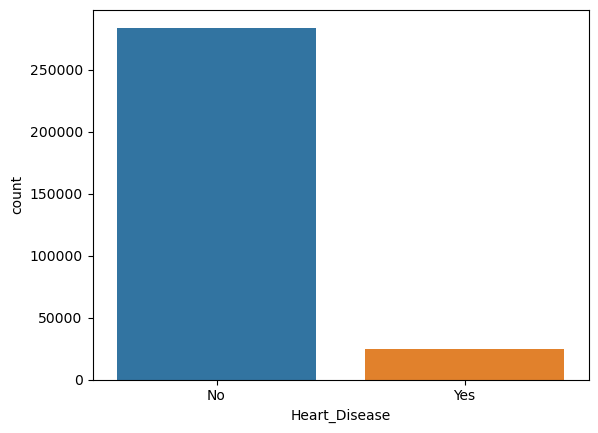

In [17]:
sns.countplot(x=my_df['Heart_Disease'])

<Axes: xlabel='Smoking_History', ylabel='count'>

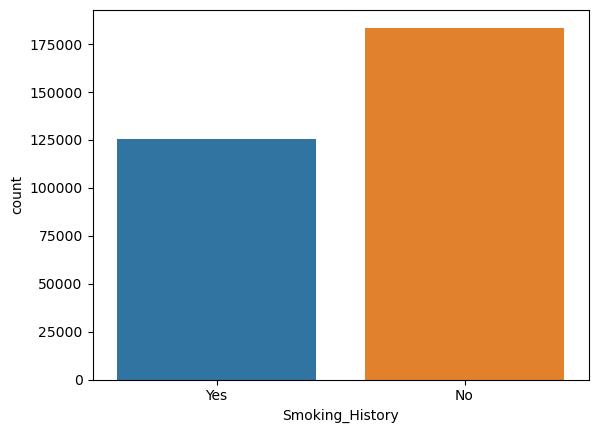

In [18]:
sns.countplot(x=my_df['Smoking_History'])

<Axes: xlabel='Skin_Cancer', ylabel='count'>

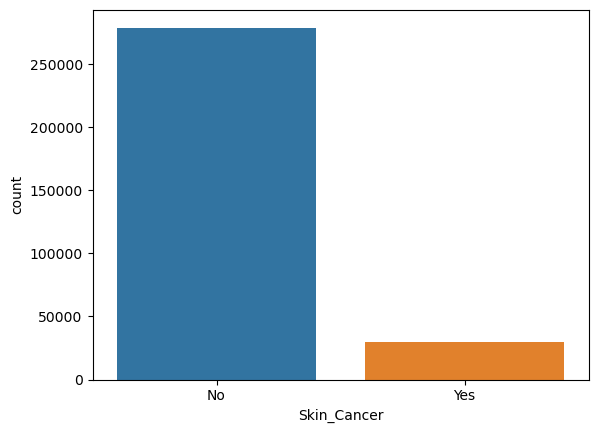

In [19]:
sns.countplot(x=my_df['Skin_Cancer'])

<Axes: xlabel='Age_Category', ylabel='count'>

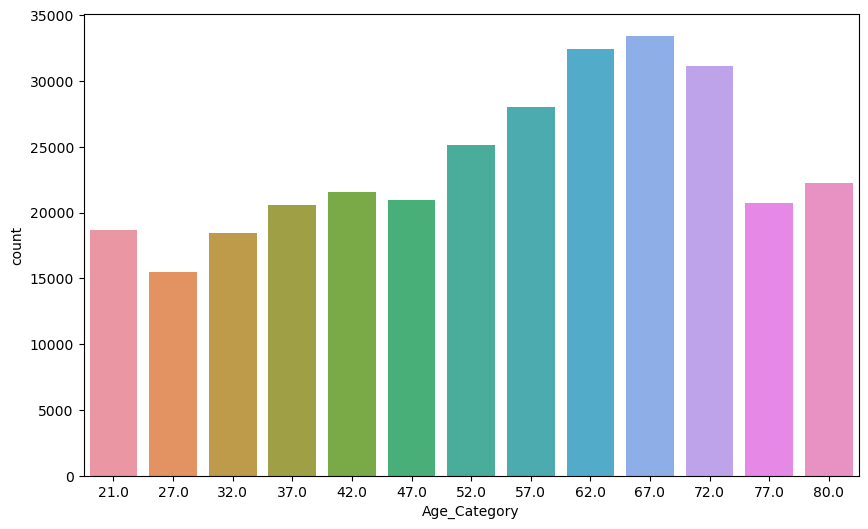

In [20]:
plt.figure(figsize=(10,6))
sns.countplot(x=my_df['Age_Category'].sort_values())

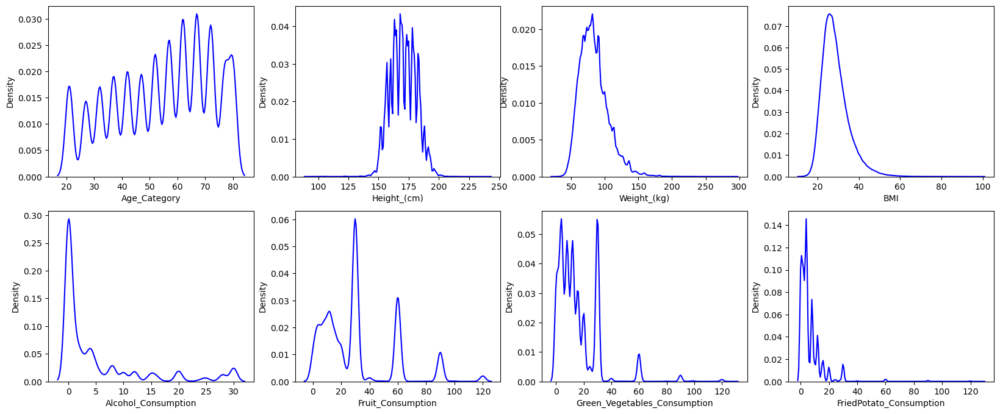

In [21]:
n_cols=4
n_rows = math.ceil(len(numerical_features)/n_cols)
fig, ax = plt.subplots(n_rows, n_cols, figsize=(20, 8))
ax = ax.flatten()
for i, column in enumerate(numerical_features):
    sns.kdeplot(
        my_df[column],
        ax=ax[i], color='blue'
    )

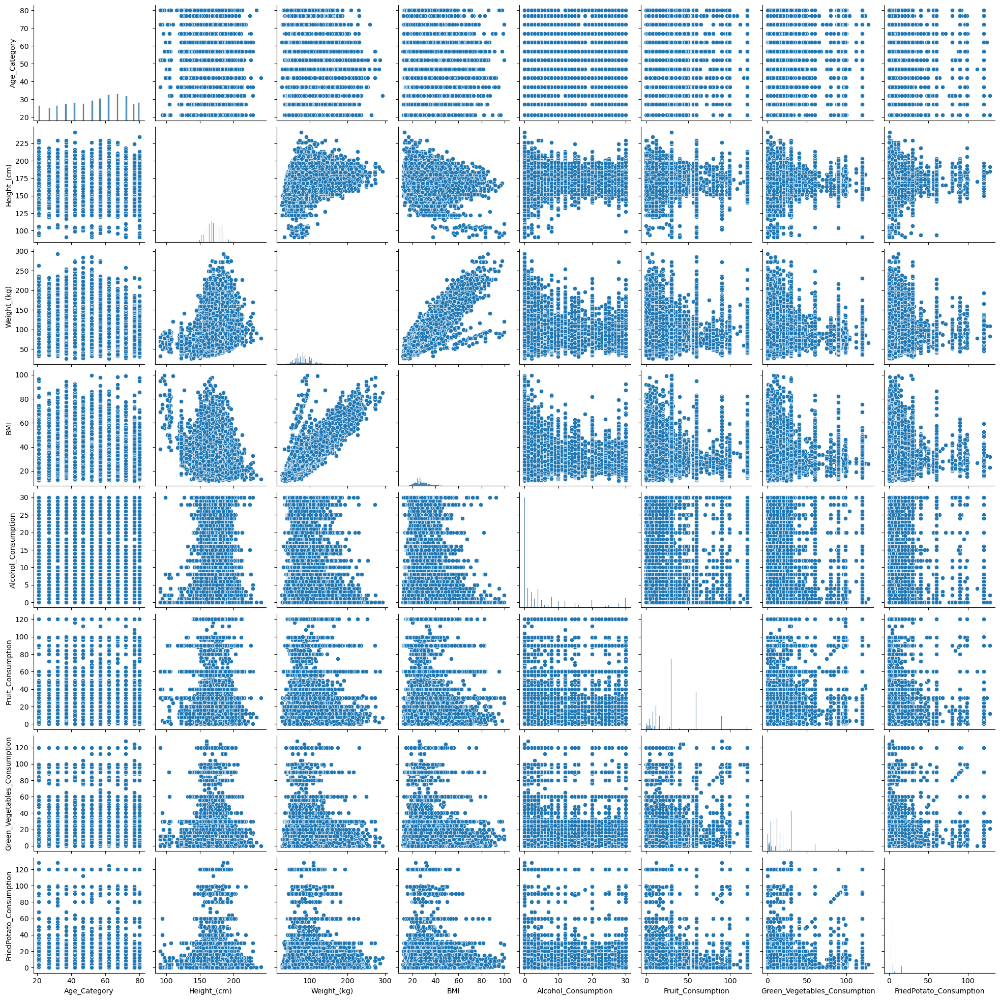

In [22]:
sns.pairplot(my_df[numerical_features])

In [23]:
correlation_matrix = my_df[numerical_features].corr()

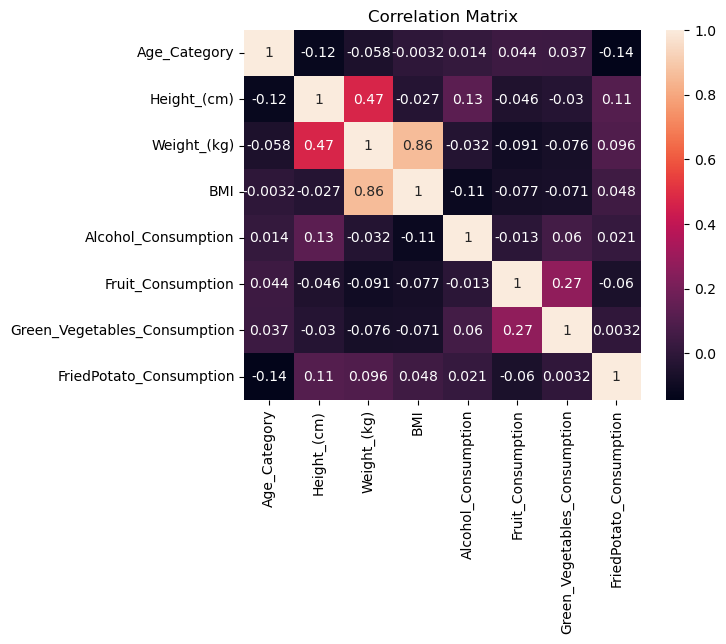

In [24]:
sns.heatmap(correlation_matrix, annot=True)
plt.title('Correlation Matrix')
plt.show()

In [25]:
scaled_numerical_features=sc.fit_transform(my_df[numerical_features])

In [26]:
scaled_numerical_features

array([[ 1.00061109, -1.93424954, -2.38617985, ...,  0.00662492,
         0.05959713,  0.66450236],
       [ 1.00061109, -0.5268572 , -0.30354689, ...,  0.00662492,
        -1.01234246, -0.26757915],
       [ 0.4296576 , -0.71450951,  0.22777049, ..., -0.71697295,
        -0.81135379,  1.13054312],
       ...,
       [-1.28320288, -1.27746645, -1.04757864, ...,  0.40862374,
        -0.47637267, -0.26757915],
       [ 0.71513434,  1.16201362, -0.19718971, ...,  0.00662492,
        -0.20838777, -0.73361991],
       [-0.42677264, -0.99598798, -0.11238508, ..., -0.99837212,
        -0.20838777, -0.61710972]])

In [27]:
embedding=reducer.fit_transform(scaled_numerical_features)

In [28]:
embedding[:10]

array([[ 3.2533076, 12.548785 ],
       [14.15761  , 13.30984  ],
       [ 4.176655 , 10.198381 ],
       [13.531218 ,  6.8881   ],
       [ 6.352253 , 13.635321 ],
       [ 6.4503713,  4.992747 ],
       [ 7.790288 , 14.676054 ],
       [ 7.4331474,  6.022177 ],
       [10.656261 , 16.012743 ],
       [11.5792885, 15.247331 ]], dtype=float32)

In [29]:
embedding.shape

(308854, 2)

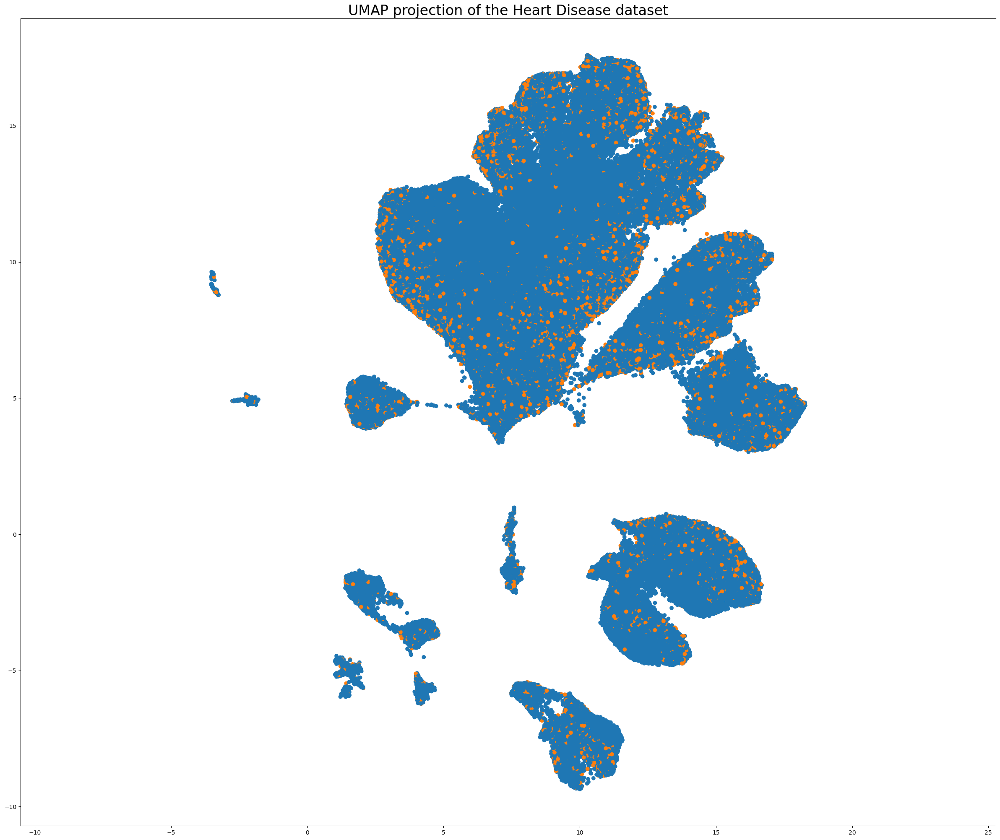

In [30]:
plt.figure(figsize=(30, 25))
plt.scatter(embedding[:,0] , embedding[:,1] , 
            c=[sns.color_palette()[x] for x in my_df.Heart_Disease.map({'No':0 , 'Yes':1})])
plt.gca().set_aspect('equal', 'datalim')
plt.title('UMAP projection of the Heart Disease dataset', fontsize=24);

# Data Preprocessing

In [31]:
# Normalization 
my_df[numerical_features]=sc.fit_transform(my_df[numerical_features])

In [32]:
my_df[numerical_features].head()

,Age_Category,Height_(cm),Weight_(kg),BMI,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,1.000611,-1.934250,-2.386180,-2.159696,-0.621527,0.006625,0.059597,0.664502
1,1.000611,-0.526857,-0.303547,-0.051548,-0.621527,0.006625,-1.012342,-0.267579
2,0.429658,-0.714510,0.227770,0.742649,-0.133707,-0.716973,-0.811354,1.130543
3,1.286088,0.880535,0.461569,0.015913,-0.621527,0.006625,0.997544,0.198462
4,1.457374,1.912623,0.227770,-0.652562,-0.621527,-0.877772,-0.744358,-0.733620


In [33]:
# Label Encoding 

for i in binary_features : 
    my_df[i] = lb.fit_transform(my_df[i])

In [34]:
my_df[binary_features].head()

,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Smoking_History
0,0,0,0,0,0,1,0,1
1,0,1,0,0,0,0,0,0
2,1,0,0,0,0,0,0,0
3,1,1,0,0,0,0,1,0
4,0,0,0,0,0,0,1,1


In [35]:
# One Hot Encoding 

for i in categorical_features : 
    my_df=my_df.join(pd.get_dummies(my_df[i],prefix=i))
    
my_df.drop(categorical_features , axis=1 , inplace=True)

In [36]:
my_df.head()

,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),...,General_Health_Very Good,Checkup_5 or more years ago,Checkup_Never,Checkup_Within the past 2 years,Checkup_Within the past 5 years,Checkup_Within the past year,Diabetes_No,"Diabetes_No, pre-diabetes or borderline diabetes",Diabetes_Yes,"Diabetes_Yes, but female told only during pregnancy"
0,0,0,0,0,0,1,0,1.000611,-1.934250,-2.386180,...,0,0,0,1,0,0,1,0,0,0
1,0,1,0,0,0,0,0,1.000611,-0.526857,-0.303547,...,1,0,0,0,0,1,0,0,1,0
2,1,0,0,0,0,0,0,0.429658,-0.714510,0.227770,...,1,0,0,0,0,1,0,0,1,0
3,1,1,0,0,0,0,1,1.286088,0.880535,0.461569,...,0,0,0,0,0,1,0,0,1,0
4,0,0,0,0,0,0,1,1.457374,1.912623,0.227770,...,0,0,0,0,0,1,1,0,0,0


In [37]:
# Correlation Matrix 
correlation_matrix = my_df.corr()
correlation_matrix

,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),...,General_Health_Very Good,Checkup_5 or more years ago,Checkup_Never,Checkup_Within the past 2 years,Checkup_Within the past 5 years,Checkup_Within the past year,Diabetes_No,"Diabetes_No, pre-diabetes or borderline diabetes",Diabetes_Yes,"Diabetes_Yes, but female told only during pregnancy"
Exercise,1.000000,-0.096347,-0.003986,-0.054388,-0.084729,-0.124813,0.059344,-0.121103,0.091618,-0.090144,...,0.137000,0.006994,-0.014107,0.032983,0.026013,-0.041233,0.139342,-0.022874,-0.142398,0.000773
Heart_Disease,-0.096347,1.000000,0.090848,0.092387,0.032526,0.153913,0.072595,0.227175,0.015780,0.045875,...,-0.101697,-0.043290,-0.009834,-0.056322,-0.048325,0.093346,-0.169569,0.019008,0.181072,-0.015198
Skin_Cancer,-0.003986,0.090848,1.000000,0.150824,-0.013014,0.136178,0.009678,0.269719,0.006812,-0.028954,...,0.000299,-0.048449,-0.014393,-0.042386,-0.046888,0.084941,-0.035442,0.007497,0.038580,-0.011504
Other_Cancer,-0.054388,0.092387,0.150824,1.000000,0.015892,0.129362,-0.042044,0.233084,-0.043459,-0.021132,...,-0.052234,-0.050465,-0.013193,-0.050805,-0.050028,0.094030,-0.066431,0.010742,0.070691,-0.010336
Depression,-0.084729,0.032526,-0.013014,0.015892,1.000000,0.121598,-0.141450,-0.102058,-0.091318,0.047936,...,-0.074013,-0.031216,-0.012610,-0.008728,-0.011449,0.030408,-0.053403,0.018278,0.044504,0.021210
Arthritis,-0.124813,0.153913,0.136178,0.129362,0.121598,1.000000,-0.100053,0.371587,-0.097789,0.074104,...,-0.087519,-0.090504,-0.025150,-0.082582,-0.088600,0.161605,-0.141405,0.039901,0.140077,-0.011373
Sex,0.059344,0.072595,0.009678,-0.042044,-0.141450,-0.100053,1.000000,-0.059936,0.698167,0.354019,...,-0.008349,0.089192,0.030387,0.018345,0.048504,-0.089565,0.002767,-0.004921,0.023557,-0.089126
Age_Category,-0.121103,0.227175,0.269719,0.233084,-0.102058,0.371587,-0.059936,1.000000,-0.119417,-0.057910,...,-0.035339,-0.117446,-0.036917,-0.136100,-0.152610,0.253765,-0.206246,0.051880,0.212603,-0.036733
Height_(cm),0.091618,0.015780,0.006812,-0.043459,-0.091318,-0.097789,0.698167,-0.119417,1.000000,0.472186,...,0.026405,0.075276,0.015096,0.023739,0.046813,-0.083574,0.038235,-0.021482,-0.013635,-0.068259
Weight_(kg),-0.090144,0.045875,-0.028954,-0.021132,0.047936,0.074104,0.354019,-0.057910,0.472186,1.000000,...,-0.066361,0.006060,-0.002515,-0.022760,-0.008049,0.019640,-0.167611,0.044591,0.169457,-0.021628


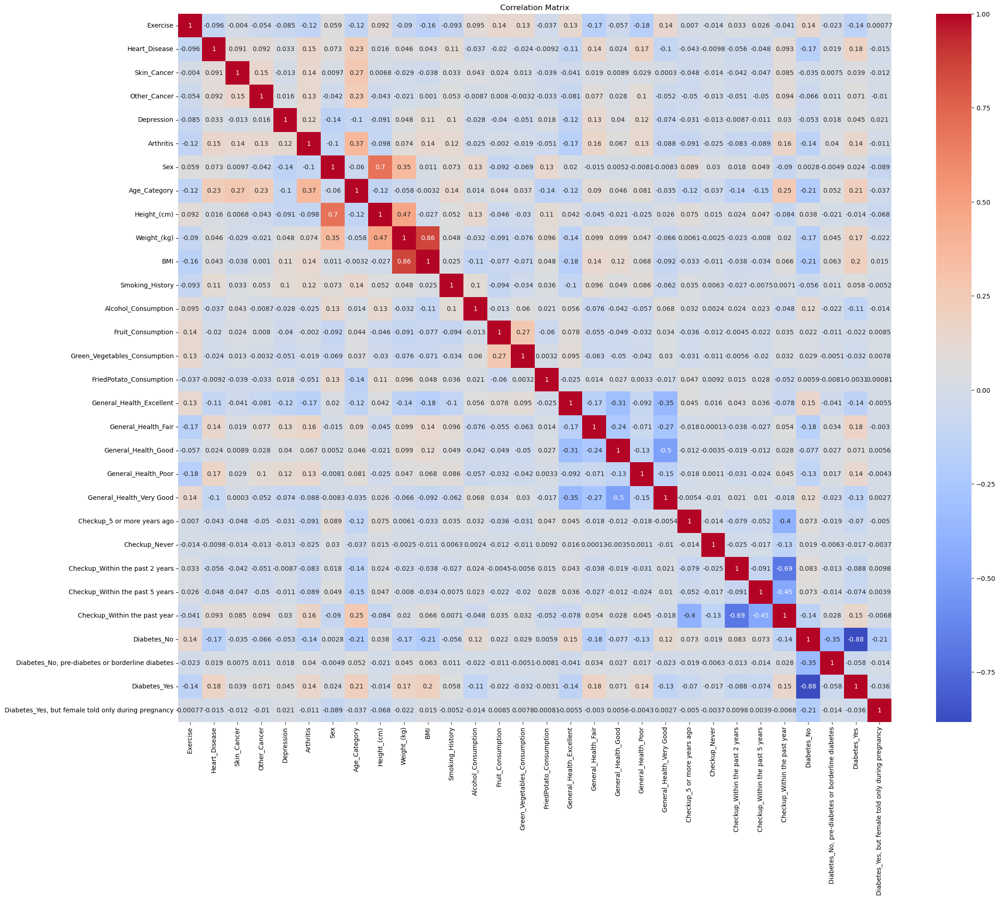

In [38]:
plt.figure(figsize=(25, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()

In [39]:
corr_features=[]
for i in correlation_matrix.columns :
    for j in correlation_matrix.index :
        if correlation_matrix.loc[i,j] >= 0.40 or correlation_matrix.loc[i,j] <= -0.55 : 
            if correlation_matrix.loc[i,j] == 1 : 
                continue 
            else : 
                print(f"Column : {i}\tRow : {j}\tCorrelation value : {correlation_matrix.loc[i,j]}")
                print("-"*200) 
                corr_features.append([i,j])

Column : Sex	Row : Height_(cm)	Correlation value : 0.6981672187205171
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Column : Height_(cm)	Row : Sex	Correlation value : 0.6981672187205171
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Column : Height_(cm)	Row : Weight_(kg)	Correlation value : 0.4721862010643849
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Column : Weight_(kg)	Row : Height_(cm)	Correlation value : 0.4721862010643849
-----------------------------------------------------------------------------------------------------

In [40]:
corr_features

[['Sex', 'Height_(cm)'],
 ['Height_(cm)', 'Sex'],
 ['Height_(cm)', 'Weight_(kg)'],
 ['Weight_(kg)', 'Height_(cm)'],
 ['Weight_(kg)', 'BMI'],
 ['BMI', 'Weight_(kg)'],
 ['Checkup_Within the past 2 years', 'Checkup_Within the past year'],
 ['Checkup_Within the past year', 'Checkup_Within the past 2 years'],
 ['Diabetes_No', 'Diabetes_Yes'],
 ['Diabetes_Yes', 'Diabetes_No']]

In [41]:
corr_names = []
corr_features_count=[]
for feature in corr_features: 
        corr_names.append(feature[0])
        
for feature in corr_names:
    if [feature,corr_names.count(feature)] not in corr_features_count : 
        corr_features_count.append([feature,corr_names.count(feature)])

In [42]:
corr_features_count

[['Sex', 1],
 ['Height_(cm)', 2],
 ['Weight_(kg)', 2],
 ['BMI', 1],
 ['Checkup_Within the past 2 years', 1],
 ['Checkup_Within the past year', 1],
 ['Diabetes_No', 1],
 ['Diabetes_Yes', 1]]

In [43]:
X=my_df.drop(['Heart_Disease'] , axis=1)
Y=my_df['Heart_Disease']

In [44]:
X.head()

,Exercise,Skin_Cancer,Other_Cancer,Depression,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,...,General_Health_Very Good,Checkup_5 or more years ago,Checkup_Never,Checkup_Within the past 2 years,Checkup_Within the past 5 years,Checkup_Within the past year,Diabetes_No,"Diabetes_No, pre-diabetes or borderline diabetes",Diabetes_Yes,"Diabetes_Yes, but female told only during pregnancy"
0,0,0,0,0,1,0,1.000611,-1.934250,-2.386180,-2.159696,...,0,0,0,1,0,0,1,0,0,0
1,0,0,0,0,0,0,1.000611,-0.526857,-0.303547,-0.051548,...,1,0,0,0,0,1,0,0,1,0
2,1,0,0,0,0,0,0.429658,-0.714510,0.227770,0.742649,...,1,0,0,0,0,1,0,0,1,0
3,1,0,0,0,0,1,1.286088,0.880535,0.461569,0.015913,...,0,0,0,0,0,1,0,0,1,0
4,0,0,0,0,0,1,1.457374,1.912623,0.227770,-0.652562,...,0,0,0,0,0,1,1,0,0,0


In [45]:
Y.head()

0    0
1    1
2    0
3    1
4    0
Name: Heart_Disease, dtype: int64

In [134]:
x_train , x_test , y_train , y_test = train_test_split(X,Y,train_size=0.80 , random_state = 42 )

In [135]:
x_train=x_train.drop('BMI' , axis=1)
x_test=x_test.drop('BMI' , axis=1)

In [136]:
x_train=np.array(x_train)
y_train=np.array(y_train)
x_test=np.array(x_test)
y_test=np.array(y_test)

In [137]:
x_train.shape , y_train.shape , x_test.shape , y_test.shape

((247083, 28), (247083,), (61771, 28), (61771,))

# Train the models & Evaluate the models

In [138]:
param_grid = {
    # 'penalty': ['l1', 'l2'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100]
}

In [139]:
# Logistic Regression 

classifier=LogisticRegression(random_state=42)
grid_search = GridSearchCV(classifier, param_grid, cv=5)

grid_search.fit(x_train, y_train)

best_params = grid_search.best_params_
train_score1 = grid_search.best_score_

print("Best hyperparameters: ", best_params)
print("Logistic Regression Classifier (train score) : ", train_score1)

accuracy1=grid_search.score(x_test, y_test)

print(f"Logistic Regression Classifier (test score) : {accuracy1}")

Best hyperparameters:  {'C': 0.001}
Logistic Regression Classifier (train score) :  0.9194238375390352
Logistic Regression Classifier (test score) : 0.9197034206990335


Logistic Regression Classifier (confusion matrix) :

[[56688    86]
 [ 4874   123]]

Recall : 0.02461476886131679
Precision : 0.5885167464114832
F1 Score 0.04725316941990012



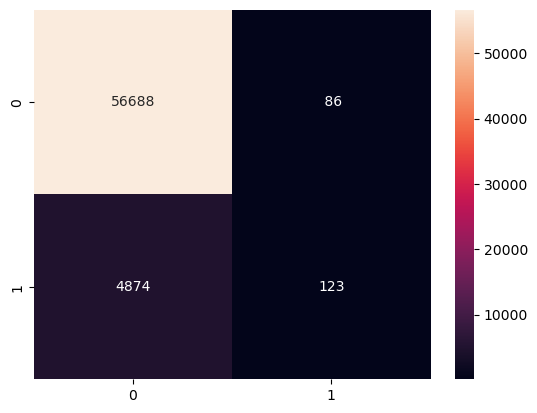

In [143]:
y_pred=grid_search.predict(x_test)

cm=confusion_matrix(y_test,y_pred)
print("Logistic Regression Classifier (confusion matrix) :\n")
print(cm)

print(f"\nRecall : {recall_score(y_test,y_pred)}")
print(f"Precision : {precision_score(y_test,y_pred)}")
print(f"F1 Score {f1_score(y_test,y_pred)}\n")

sns.heatmap(cm, annot=True,fmt='3g')
plt.show()

In [144]:
param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 5],
    'max_leaf_nodes':[5,8,10],
}

In [145]:
# DT

dt = DecisionTreeClassifier()

grid_search = GridSearchCV(dt, param_grid, cv=5)

grid_search.fit(x_train,y_train)

train_score2 = grid_search.best_score_

print("Best parameters:", grid_search.best_params_)

print("Decision Tree Classifier (train score) : ", train_score2)


accuracy2=grid_search.score(x_test, y_test)


print("Decision Tree Classifier (test score) : ", accuracy2)

Best parameters: {'criterion': 'gini', 'max_depth': None, 'max_leaf_nodes': 5, 'min_samples_leaf': 1, 'min_samples_split': 2}
Decision Tree Classifier (train score) :  0.9191607678803425
Decision Tree Classifier (test score) :  0.9191044341195707


Decision Tree Classifier (confusion matrix) :

[[56774     0]
 [ 4997     0]]

Recall : 0.0
Precision : 0.0
F1 Score 0.0



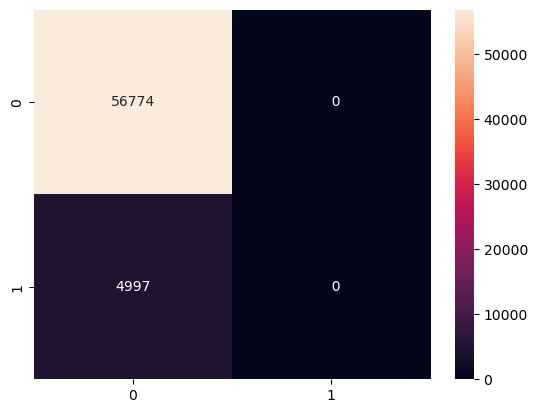

In [146]:
y_pred=grid_search.predict(x_test)

cm=confusion_matrix(y_test,y_pred)
print("Decision Tree Classifier (confusion matrix) :\n")
print(cm)

print(f"\nRecall : {recall_score(y_test,y_pred)}")
print(f"Precision : {precision_score(y_test,y_pred)}")
print(f"F1 Score {f1_score(y_test,y_pred)}\n")

sns.heatmap(cm, annot=True,fmt='3g')
plt.show()

In [147]:
# Random Forest

rfc=RandomForestClassifier(max_depth=5,n_estimators=10,max_features=10, random_state=42)

rfc.fit(x_train, y_train)
train_score3=rfc.score(x_train,y_train)
print("Random Forest Classifier (test score) : ",train_score3)
accuracy3 = rfc.score(x_test, y_test)
print("Random Forest Classifier (test score) : ", accuracy3)

Random Forest Classifier (test score) :  0.9194885929019803
Random Forest Classifier (test score) :  0.9194120218225381


Random Forest Classifier (confusion matrix) :

[[56733    41]
 [ 4937    60]]

Recall : 0.012007204322593557
Precision : 0.594059405940594
F1 Score 0.02353864260494312



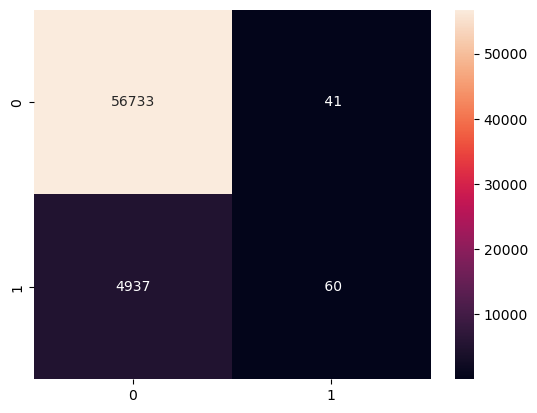

In [148]:
y_pred=rfc.predict(x_test)
cm=confusion_matrix(y_test,y_pred)
print("Random Forest Classifier (confusion matrix) :\n")
print(cm)

print(f"\nRecall : {recall_score(y_test,y_pred)}")
print(f"Precision : {precision_score(y_test,y_pred)}")
print(f"F1 Score {f1_score(y_test,y_pred)}\n")

sns.heatmap(cm, annot=True,fmt='3g')
plt.show()

# PCA ( Principle Componenet Analysis )

In [46]:
pca=PCA()
pca.fit(X)

PCA()

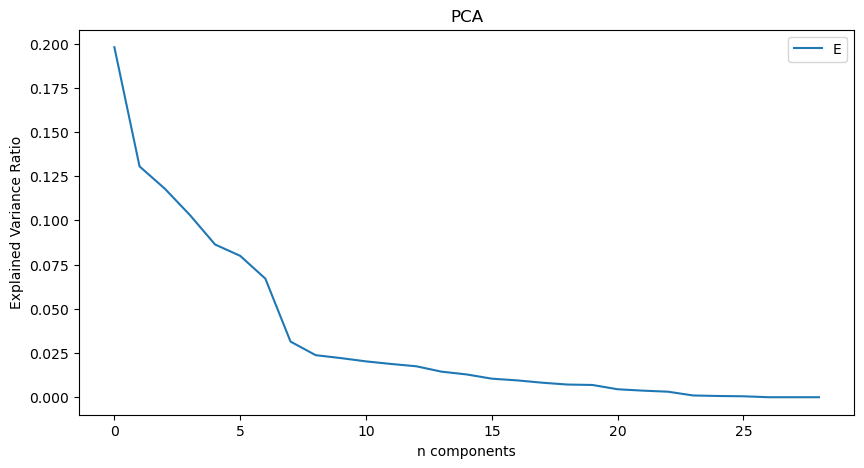

In [47]:
plt.figure(figsize=(10,5))
plt.title('PCA')
plt.plot(pca.explained_variance_ratio_)
plt.legend('Explained Variance')
plt.xlabel('n components')
plt.ylabel('Explained Variance Ratio')
plt.show()

In [48]:
n_components=3
pca = PCA(n_components=n_components)
x_pca=pca.fit_transform(X)
df_pca = pd.DataFrame(x_pca,columns=['PC{}'.format(i+1)for i in range(n_components)])
df_pca.head()
x_pca=df_pca.values

In [49]:
print(pca.explained_variance_ratio_)

[0.19791145 0.13051375 0.11798372]


In [50]:
pca.components_

array([[-3.56458565e-02, -1.09430984e-02, -7.74829551e-03,
         1.85200959e-02,  1.50798558e-02,  1.43057051e-01,
        -9.75915138e-02,  3.46448835e-01,  6.68444200e-01,
         5.63339703e-01,  2.30317694e-02, -3.77593014e-02,
        -1.69907786e-01, -1.49574946e-01,  1.48971604e-01,
        -4.20998077e-02,  2.49408773e-02,  3.89810558e-02,
         6.97718855e-03, -2.87993139e-02,  4.26320802e-03,
         2.52344076e-04, -2.52126333e-03,  1.88275076e-03,
        -3.87703953e-03, -4.35987998e-02,  4.41459939e-03,
         4.05724854e-02, -1.38828495e-03],
       [-7.97176526e-02,  2.56772383e-02,  3.85913592e-02,
         3.05982979e-02,  1.40171658e-01, -2.08115178e-01,
         4.39932692e-01, -5.30332021e-01,  7.94546331e-02,
         3.88932772e-01,  3.48536493e-03, -3.89107188e-01,
         5.01961786e-02, -4.26625448e-02, -3.18928106e-01,
        -6.49440735e-02,  4.72584454e-02,  4.82636325e-02,
         1.82809999e-02, -4.88590043e-02, -2.56197760e-02,
        -2.10

In [51]:
print(pca.components_.shape)

(3, 29)


In [52]:
loading_scores = pd.Series(pca.components_[0], index=X.columns)
sorted_loading_scores = loading_scores.abs().sort_values(ascending=False)
top_features = sorted_loading_scores[0:26].index.values
print(loading_scores[top_features])

Weight_(kg)                                         0.668444
BMI                                                 0.563340
Height_(cm)                                         0.346449
Fruit_Consumption                                  -0.169908
Green_Vegetables_Consumption                       -0.149575
FriedPotato_Consumption                             0.148972
Sex                                                 0.143057
Age_Category                                       -0.097592
Diabetes_No                                        -0.043599
General_Health_Excellent                           -0.042100
Diabetes_Yes                                        0.040572
General_Health_Good                                 0.038981
Alcohol_Consumption                                -0.037759
Exercise                                           -0.035646
General_Health_Very Good                           -0.028799
General_Health_Fair                                 0.024941
Smoking_History         

In [53]:
fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', color=df_pca.index, color_discrete_sequence=['#C00000', '#00B050', '#0070C0'])
fig.update_traces(marker=dict(size=5, opacity=0.8))
fig.show()

In [54]:
x_train_pca , x_test_pca , y_train_pca , y_test_pca = train_test_split(x_pca , Y.values , train_size = 0.80 , random_state = 42 )

In [55]:
x_train_pca.shape , y_train_pca.shape , x_test_pca.shape , y_test_pca.shape

((247083, 3), (247083,), (61771, 3), (61771,))

In [56]:
x_train_pca=torch.FloatTensor(x_train_pca)
x_test_pca=torch.FloatTensor(x_test_pca)
y_train_pca=torch.FloatTensor(y_train_pca)
y_test_pca=torch.FloatTensor(y_test_pca)

In [57]:
y_train_pca=y_train_pca.unsqueeze(dim=1)
y_test_pca=y_test_pca.unsqueeze(dim=1)

In [58]:
train_pca = TensorDataset(x_train_pca , y_train_pca) 
test_pca = TensorDataset(x_test_pca , y_test_pca)

In [59]:
BATCH_SIZE = 128 

In [60]:
torch.manual_seed(42)
train_dataloader = DataLoader(
    dataset = train_pca , 
    batch_size = BATCH_SIZE , 
    shuffle = True 
)

In [61]:
torch.manual_seed(42)
test_dataloader = DataLoader(
    dataset = test_pca , 
    batch_size = BATCH_SIZE , 
    shuffle = False 
)

In [62]:
print(f"the size of the train dataloader {len(train_dataloader)} batches of {BATCH_SIZE}")

the size of the train dataloader 1931 batches of 128


In [63]:
print(f"the size of the test dataloader {len(test_dataloader)} batches of {BATCH_SIZE}")

the size of the test dataloader 483 batches of 128


In [64]:
trainimage_sample , trainlabel_sample = next(iter(train_dataloader)) 
trainimage_sample.shape , trainlabel_sample.shape

(torch.Size([128, 3]), torch.Size([128, 1]))

In [65]:
def param_count(model):
    params = [p.numel() for p in model.parameters() if p.requires_grad]
    print('Total number of parameters : ', sum(params))

In [66]:
class BasicNN(nn.Module) : 
    def __init__(self,input_shape,hidden_units,output) : 
        super().__init__() 
        self.layer1=nn.Linear(input_shape,hidden_units)
        self.layer2=nn.Linear(hidden_units,hidden_units)
        self.out=nn.Linear(hidden_units,output)
        
    def forward(self,x) : 
        x=F.relu(self.layer1(x))
        x=F.relu(self.layer2(x))
        x=F.sigmoid(self.out(x))
        
        return x

In [67]:
torch.manual_seed(42)
model=BasicNN(input_shape=3,hidden_units=10,output=1)

In [68]:
model.parameters

<bound method Module.parameters of BasicNN(
  (layer1): Linear(in_features=3, out_features=10, bias=True)
  (layer2): Linear(in_features=10, out_features=10, bias=True)
  (out): Linear(in_features=10, out_features=1, bias=True)
)>

In [69]:
param_count(model)

Total number of parameters :  161


In [70]:
criterion=nn.BCELoss()
optimizer=Adam(model.parameters(), lr=0.01)

In [72]:
epochs = 10 
training_loss = [] 
training_acc = [] 

for i in tqdm(range(epochs)) : 
    epoch_loss=0
    epoch_acc=0 
    
    for batch , (x_train , y_train) in enumerate(train_dataloader) : 
        y_pred = model.forward(x_train) 
        loss = criterion(y_pred , y_train)
          
        loss.backward()
        optimizer.step()
        optimizer.zero_grad()
        
        epoch_loss += loss 
        epoch_acc += accuracy_score(y_train , y_pred.argmax(dim=1))
        
        
    training_loss.append((epoch_loss/len(train_dataloader)).detach().numpy())
    training_acc.append(epoch_acc/len(train_dataloader))
    print(f"Epoch {i}: Accuracy: {(epoch_acc/len(train_dataloader)) * 100}, Loss: {(epoch_loss/len(train_dataloader))}\n\n")

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch 0: Accuracy: 91.91725729529223, Loss: 0.2727452516555786


Epoch 1: Accuracy: 91.91725729529223, Loss: 0.2684360444545746


Epoch 2: Accuracy: 91.91645753796683, Loss: 0.2681974768638611


Epoch 3: Accuracy: 91.91565778064144, Loss: 0.2678122818470001


Epoch 4: Accuracy: 91.91645753796683, Loss: 0.26729467511177063


Epoch 5: Accuracy: 91.91405826599063, Loss: 0.26727303862571716


Epoch 6: Accuracy: 91.91485802331604, Loss: 0.26713764667510986


Epoch 7: Accuracy: 91.91805705261763, Loss: 0.26693087816238403


Epoch 8: Accuracy: 91.91725729529223, Loss: 0.2670281231403351


Epoch 9: Accuracy: 91.91725729529223, Loss: 0.26682525873184204




In [74]:
print(f"The loss of the training set is : {training_loss[-1]}\n")
print(f"The accuracy of the training set is : {training_acc[-1] * 100}%")

The loss of the training set is : 0.26682525873184204

The accuracy of the training set is : 91.91725729529223%


In [151]:
train_score4 = training_acc[-1]

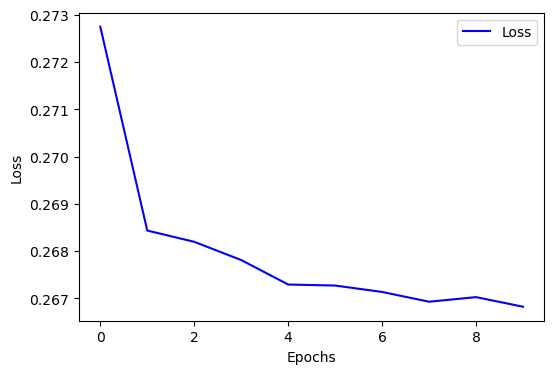

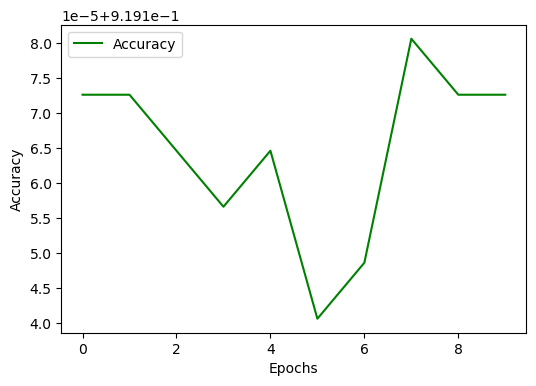

In [78]:
plt.subplots(figsize=(6,4))
plt.plot(range(epochs),training_loss,color="blue",label="Loss")
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.subplots(figsize=(6,4))
plt.plot(range(epochs),training_acc,color="green",label="Accuracy")
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [114]:
torch.manual_seed(42)
testing_acc=0
testing_loss=0 

with torch.no_grad() : 
    for x_test , y_test in test_dataloader : 
        y_pred = model.forward(x_test) 
        
        loss = criterion(y_pred , y_test ) 
        
        testing_loss+=loss 
        testing_acc += accuracy_score(y_test , y_pred.argmax(dim=1))
        
testing_loss /= len(test_dataloader) 
testing_acc /= len(test_dataloader)

In [115]:
print(f"The loss of the testing set is : {testing_loss}\n")
print(f"The accuracy of the testing set is : {testing_acc*100}%\n")

The loss of the testing set is : 0.2665436863899231

The accuracy of the testing set is : 91.91509230503796%



In [150]:
accuracy4 = testing_acc

In [131]:
y_test_preds=[]

with torch.no_grad() : 
    for data in x_test_pca : 
        y_pred = model.forward(data) 
        y_pred=torch.round(y_pred)
        y_test_preds.append(y_pred.detach().numpy())

Neural Network Classifier (confusion matrix) :

[[56774     0]
 [ 4997     0]]

Recall : 0.0
Precision : 0.0
F1 Score 0.0



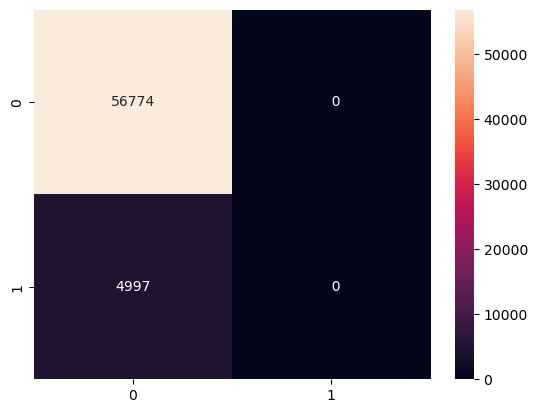

In [133]:
cm=confusion_matrix(y_test_pca,y_test_preds)
print("Neural Network Classifier (confusion matrix) :\n")
print(cm)
print(f"\nRecall : {recall_score(y_test_pca,y_test_preds)}")
print(f"Precision : {precision_score(y_test_pca,y_test_preds)}")
print(f"F1 Score {f1_score(y_test_pca,y_test_preds)}\n")

sns.heatmap(cm, annot=True,fmt='3g')
plt.show()

# Compare between models

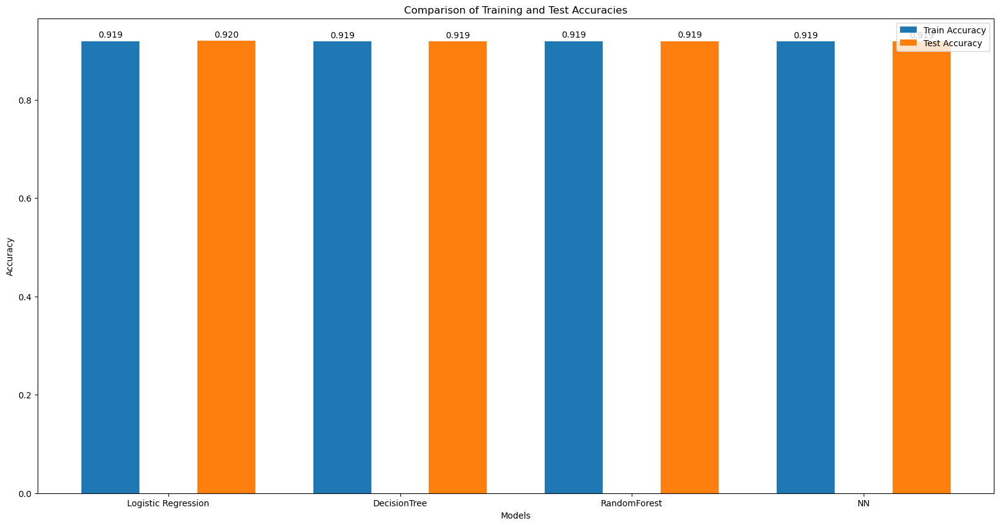

In [152]:
# plot all models 

train_scores=[train_score1,train_score2,train_score3,train_score4]
test_scores=[accuracy1,accuracy2,accuracy3,accuracy4]

models = ['Logistic Regression', 'DecisionTree', 'RandomForest', 'NN']

x = np.arange(len(models))

width = 0.25

fig, ax = plt.subplots(figsize=(20, 10))

rects1 = ax.bar(x - width, train_scores, width, label='Train Accuracy')

rects2 = ax.bar(x + width, test_scores, width, label='Test Accuracy')

ax.set_xlabel('Models')
ax.set_ylabel('Accuracy')
ax.set_title('Comparison of Training and Test Accuracies')
ax.set_xticks(x)
ax.set_xticklabels(models)
ax.legend()

def autolabel(rects):
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{:.3f}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 2),
                    textcoords="offset points",
                    ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

plt.show()